In [1]:
import pandas as pd
import numpy as np
from sentence_transformers import SentenceTransformer
from umap import UMAP
import umap.plot
import hdbscan
import plotly_express as px

C:\Python39\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
# def f():
#     ada_emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada.npy")
#     umap_model = UMAP(n_neighbors=15,
#                                              n_components=2,
#                                              min_dist=0.0,
#                                              metric='cosine',
#                                              low_memory=False)
#     print("fitting umap model")
#     ada_emb = umap_model.fit_transform(ada_emb)
#     print("ploting")
#     umap.plot.points(umap_model)
#     np.save("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada_2.npy", ada_emb)
#     print(ada_emb.shape)
# f()

ada_emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada.npy")
umap_model = UMAP(n_neighbors=15,
                                             n_components=3,
                                             min_dist=0.0,
                                             metric='cosine',
                                             low_memory=False)
ada_emb = umap_model.fit_transform(ada_emb)
#np.save("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada_2.npy", ada_emb)

In [6]:
ada_emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada_2.npy")
px.scatter_3d(x=ada_emb[:,0], y=ada_emb[:,1], z=ada_emb[:,2], title="Distribution after UMAP for ADA")

In [70]:
clusterer.labels_

array([251,  -1, 176, ..., 393,  -1, 218], dtype=int64)

In [5]:

clusterer = hdbscan.HDBSCAN(min_cluster_size=10,
                                                              metric='euclidean',
                                                              cluster_selection_method='eom',
                                                              prediction_data=True)
clusterer.fit(ada_emb)
palette = px.colors.qualitative.Alphabet
if -1 in clusterer.labels_:
    global palette
    palette = [color for color in palette if color != 'red']
print(len(palette))
px.scatter_3d(x=ada_emb[:,0], y=ada_emb[:,1], z=ada_emb[:,2], color=clusterer.labels_.astype(str), title="UMAP => HDBSCAN for ada",
              color_discrete_sequence=palette,
              labels={-1: " "})

26


In [78]:
mask = clusterer.labels_.astype(str) != "-1"
filtered_data = ada_emb[mask]
filtered_label = clusterer.labels_[mask]
filtered_data.shape
px.scatter_3d(x=filtered_data[:,0], y=filtered_data[:,1], z=filtered_data[:,2], color=filtered_label.astype(str), title="UMAP => HDBSCAN for ada")

In [7]:
# import pandas as pd
# import numpy as np
# from sentence_transformers import SentenceTransformer
# from umap import UMAP
# import umap.plot

# def f():
#     bert_emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_bert_np.npy")
#     umap_model = UMAP(n_neighbors=15,
#                                              n_components=2,
#                                              min_dist=0.0,
#                                              metric='cosine',
#                                              low_memory=False)
#     print("fitting umap model")
#     bert_emb = umap_model.fit_transform(bert_emb)
#     print("ploting")
#     umap.plot.points(umap_model)
#     #np.save("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_bert_np_umap.npy", bert_emb)
# f()
import plotly_express as px
bert_emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_bert_np.npy")
umap_model = UMAP(n_neighbors=15,
                                             n_components=3,
                                             min_dist=0.0,
                                             metric='cosine',
                                             low_memory=False)
bert_emb = umap_model.fit_transform(bert_emb)
np.save("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_bert_np_umap.npy", bert_emb)
px.scatter_3d(x=bert_emb[:,0], y=bert_emb[:,1], z=bert_emb[:,2], title="Distribution after UMAP for SBERT")

In [81]:
mask = clusterer.labels_.astype(str) != "-1"
filtered_data = bert_emb[mask]
filtered_label = clusterer.labels_[mask]
filtered_data.shape
px.scatter_3d(x=filtered_data[:,0], y=filtered_data[:,1], z=filtered_data[:,2], color=filtered_label.astype(str), title="UMAP => HDBSCAN for ada")

array([483,  -1, 933, ..., 826, 688, 364], dtype=int64)

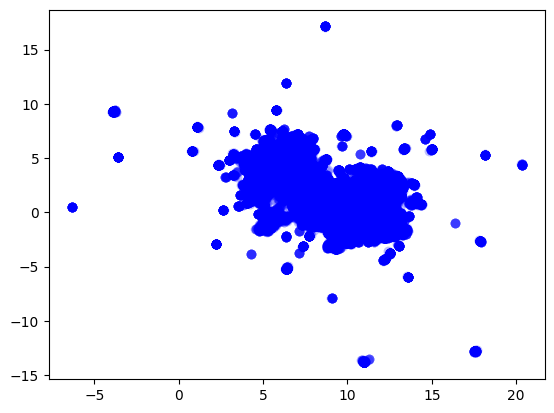

In [1]:
# mask = clusterer.labels_.astype(str) != "-1"
# filtered_data = bert_emb[mask]
# filtered_label = clusterer.labels_[mask]
# filtered_data.shape
# px.scatter_3d(x=filtered_data[:,0], y=filtered_data[:,1], z=filtered_data[:,2], color=filtered_label.astype(str), title="UMAP => HDBSCAN for ada")

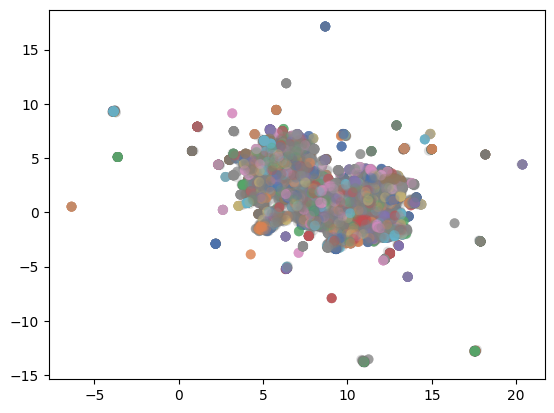

In [2]:
# color_palette = sns.color_palette('deep', len(clusterer.labels_))
# cluster_colors = [color_palette[x] if x >= 0
#                   else (0.5, 0.5, 0.5)
#                   for x in clusterer.labels_]
# cluster_member_colors = [sns.desaturate(x, p) for x, p in
#                          zip(cluster_colors, clusterer.probabilities_)]
# plt.scatter(*emb.T, s=50, linewidth=0, c=cluster_member_colors, alpha=0.25)

array([ -1, 767, 436, ..., 351, 653, 675], dtype=int64)

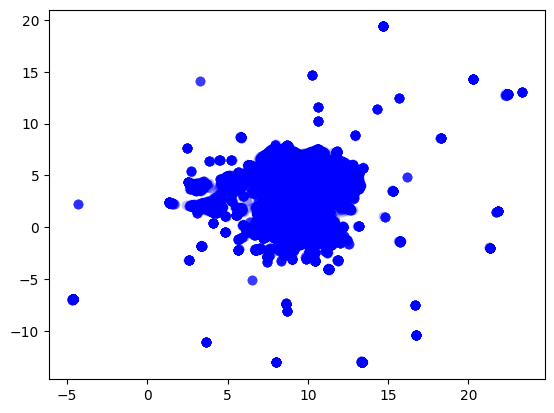

In [26]:
# import hdbscan
# import numpy as np
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np

# emb = np.load("C:\\Users\\tom19\\IdeaProjects\\GPTopic\\trump_twitter_np_ada_2.npy")
# emb.shape
# plt.scatter(*emb.T, s=50, linewidth=0, c='b', alpha=0.25)
# clusterer = hdbscan.HDBSCAN(min_cluster_size=self.min_topic_size,
#                                                               metric='euclidean',
#                                                               cluster_selection_method='eom',
#                                                               prediction_data=True)
# clusterer.fit(emb)
# clusterer.labels_

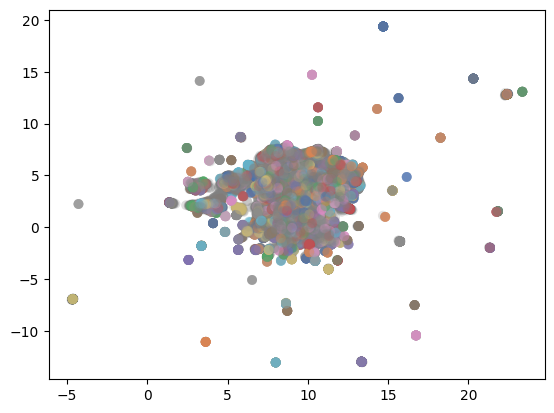

In [43]:
# sorted(zip(clusterer.labels_,
#                                                             clusterer.probabilities_),key = lambda x: -x[1])[28310]

(17, 0.015381779480907918)

In [41]:
# np.count_nonzero(clusterer.probabilities_)

28338

In [ ]:
# color_palette = sns.color_palette('deep', len(clusterer.labels_))
# cluster_colors = [color_palette[x] if x >= 0
#                   else (0.5, 0.5, 0.5)
#                   for x in clusterer.labels_]
# cluster_member_colors = [sns.desaturate(x, p) for x, p in
#                          zip(cluster_colors, clusterer.probabilities_)]
# plt.scatter(*emb.T, s=50, linewidth=0, c=cluster_member_colors, alpha=0.25)